# Capstone Project: Hotel Booking Cancellation Prediction

## `Objective` is to build a Machine Learning model to help the Hotel Owners better understand if the customer is going to honour the reservation or cancel it.

- EDA (Exploratory Data Analysis)
- Model Applied: Random Forest (Machine Learning)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

##### 1. Data Import

In [2]:
df = pd.read_csv(r"C:\Users\mohds\Downloads\Machine Learning\Project\hotel_booking.csv")
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,...,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,avg_daily_rate,required_car_parking_spaces,total_of_special_requests
0,City Hotel,0,37,2016,January,0,2,2,0,BB,...,0,0,0,D,1,No Deposit,0,84.45,0,1
1,City Hotel,0,11,2015,October,2,1,1,0,BB,...,0,0,0,B,1,No Deposit,0,95.00,0,0
2,Resort Hotel,0,21,2015,July,2,3,2,0,HB,...,0,0,0,C,1,No Deposit,0,165.00,1,3
3,Resort Hotel,1,116,2016,June,3,5,2,0,BB,...,0,0,0,C,0,No Deposit,0,145.88,0,0
4,Resort Hotel,1,345,2016,September,2,7,2,0,BB,...,0,0,0,G,2,No Deposit,0,145.00,0,1


In [3]:
df.shape

(119390, 21)

##### 2. Data Pre-Processing

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   stays_in_weekend_nights         119390 non-null  int64  
 6   stays_in_week_nights            119390 non-null  int64  
 7   adults                          119390 non-null  int64  
 8   children                        119390 non-null  int64  
 9   meal                            119390 non-null  object 
 10  market_segment                  119390 non-null  object 
 11  is_repeated_guest               119390 non-null  int64  
 12  previous_cancell

In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
is_canceled,119390.0,0.370416,0.482918,0.0,0.00,0.000,1.0,1.0
lead_time,119390.0,104.011416,106.863097,0.0,18.00,69.000,160.0,737.0
arrival_date_year,119390.0,2016.156554,0.707476,2015.0,2016.00,2016.000,2017.0,2017.0
stays_in_weekend_nights,119390.0,0.927599,0.998613,0.0,0.00,1.000,2.0,19.0
stays_in_week_nights,119390.0,2.500302,1.908286,0.0,1.00,2.000,3.0,50.0
adults,119390.0,1.856403,0.579261,0.0,2.00,2.000,2.0,55.0
children,119390.0,0.103886,0.398555,0.0,0.00,0.000,0.0,10.0
is_repeated_guest,119390.0,0.031912,0.175767,0.0,0.00,0.000,0.0,1.0
previous_cancellations,119390.0,0.087118,0.844336,0.0,0.00,0.000,0.0,26.0
previous_bookings_not_canceled,119390.0,0.137097,1.497437,0.0,0.00,0.000,0.0,72.0


In [6]:
df.isnull().sum()

hotel                             0
is_canceled                       0
lead_time                         0
arrival_date_year                 0
arrival_date_month                0
stays_in_weekend_nights           0
stays_in_week_nights              0
adults                            0
children                          0
meal                              0
market_segment                    0
is_repeated_guest                 0
previous_cancellations            0
previous_bookings_not_canceled    0
assigned_room_type                0
booking_changes                   0
deposit_type                      0
days_in_waiting_list              0
avg_daily_rate                    0
required_car_parking_spaces       0
total_of_special_requests         0
dtype: int64

In [7]:
import plotly.express as px

fig = px.pie(df, names = 'is_canceled', color = 'is_canceled',
             color_discrete_map = {0:'green',
                                   1:'red'})
fig.show()

* As it appears the cancellation rate is High which is not an good sign for the organization

In [8]:
df[df['avg_daily_rate'] == 0]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,...,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,avg_daily_rate,required_car_parking_spaces,total_of_special_requests
75,Resort Hotel,0,0,2015,November,0,0,2,0,BB,...,0,0,0,E,0,No Deposit,0,0.0,1,1
123,Resort Hotel,1,5,2016,August,0,1,2,0,BB,...,0,0,0,C,0,No Deposit,0,0.0,0,0
227,Resort Hotel,0,3,2015,December,0,0,2,0,BB,...,0,0,0,D,0,No Deposit,0,0.0,0,2
257,Resort Hotel,0,1,2016,February,0,1,2,0,BB,...,0,0,0,H,1,No Deposit,0,0.0,1,2
261,Resort Hotel,0,6,2016,March,0,2,2,0,BB,...,0,0,0,D,0,No Deposit,0,0.0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118634,City Hotel,0,78,2017,August,0,0,1,0,BB,...,0,0,0,K,7,No Deposit,0,0.0,0,0
118765,City Hotel,0,1,2017,August,0,1,2,1,BB,...,0,0,0,D,1,No Deposit,0,0.0,0,3
118965,City Hotel,0,1,2017,August,0,0,2,0,BB,...,0,0,0,A,0,No Deposit,0,0.0,0,0
119103,City Hotel,0,518,2017,August,2,1,1,0,BB,...,0,0,0,A,1,No Deposit,0,0.0,0,0


- There are quite a few hotel rooms which have a price equal to 0.

In [9]:
df.loc[df['avg_daily_rate'] == 0, 'market_segment'].value_counts()

Complementary    680
Online           367
Offline          332
Groups           253
Direct           240
Corporate         82
Aviation           6
Name: market_segment, dtype: int64

* The most values with room price equal to 0 are the rooms given as Complementary service from the hotel.
* The rooms booked from other market segments must be a part of some promotional campaign done by the hotel.

##### No. of Childrens

In [10]:
df['children'].value_counts(normalize=True)

0     0.928051
1     0.040715
2     0.030589
3     0.000637
10    0.000008
Name: children, dtype: float64

- Customers travelling with no children is 92.8% of cases, while 4% or 3% with 1 or 2 childrens respectively.
- There are some values in the data where the number of children is 10, which is highly unlikely.

In [11]:
df['children'] = df['children'].replace([3, 10], 2)

##### Arrival Month

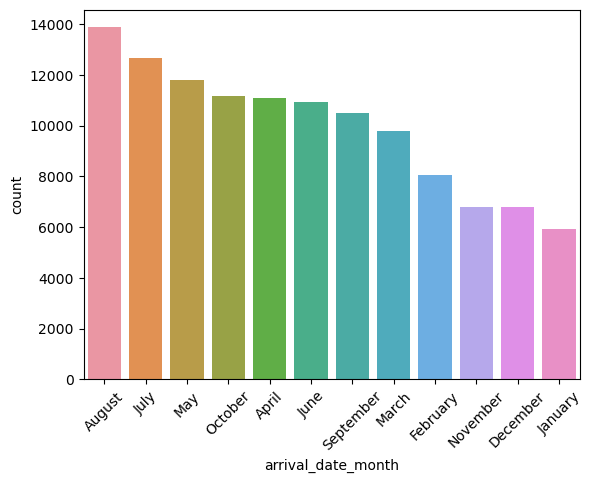

In [12]:
sns.countplot(data = df, x = 'arrival_date_month', order = df['arrival_date_month'].value_counts().sort_values(ascending=False).index)
plt.xticks(rotation = 45)
plt.show()

In [13]:
df['arrival_date_month'].value_counts(normalize=True)*100

August       11.623252
July         10.604741
May           9.876037
October       9.347517
April         9.288048
June          9.162409
September     8.801407
March         8.203367
February      6.757685
November      5.690594
December      5.678868
January       4.966078
Name: arrival_date_month, dtype: float64

* August is the busiest month for hotel arrivals followed by July and May, which is over 32% of all bookings.
* Around 11.62% of the bookings were made for an October arrival.

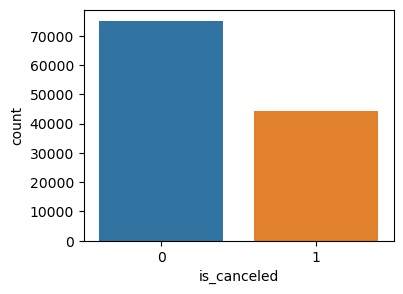

In [14]:
plt.figure(figsize=(4,3))
sns.countplot(data = df, x = 'is_canceled')
plt.show()

In [15]:
df['is_canceled'].value_counts(normalize=True)*100

0    62.958372
1    37.041628
Name: is_canceled, dtype: float64

* 37% of the bookings were cancelled by the customers.

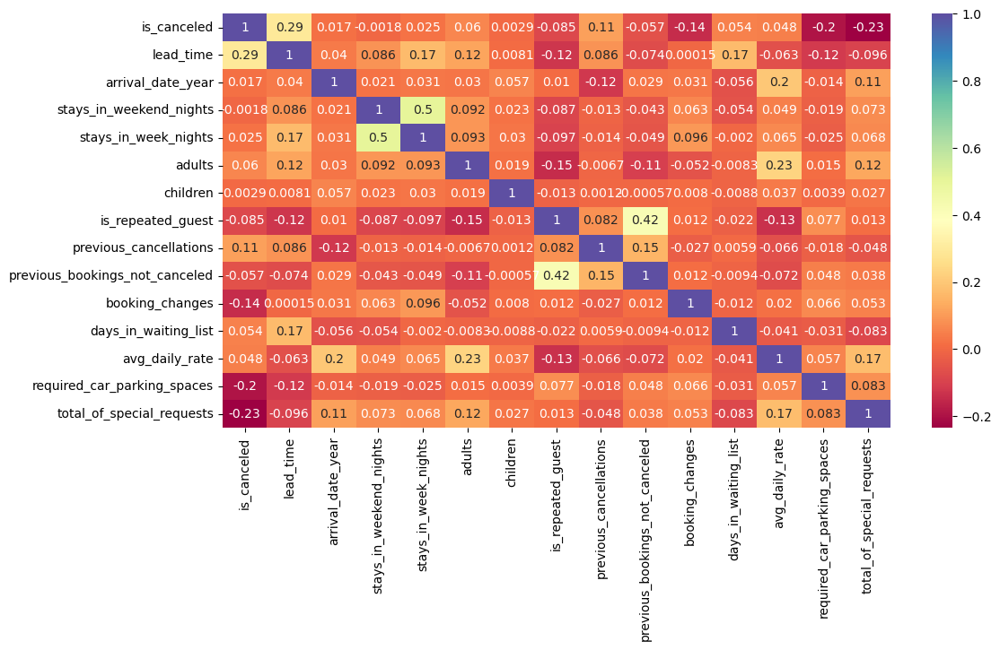

In [16]:
plt.figure(figsize=(12,6))
sns.heatmap(df.corr(), annot=True, cmap='Spectral')
plt.show()

##### Hotel rates with respect to customer segment type

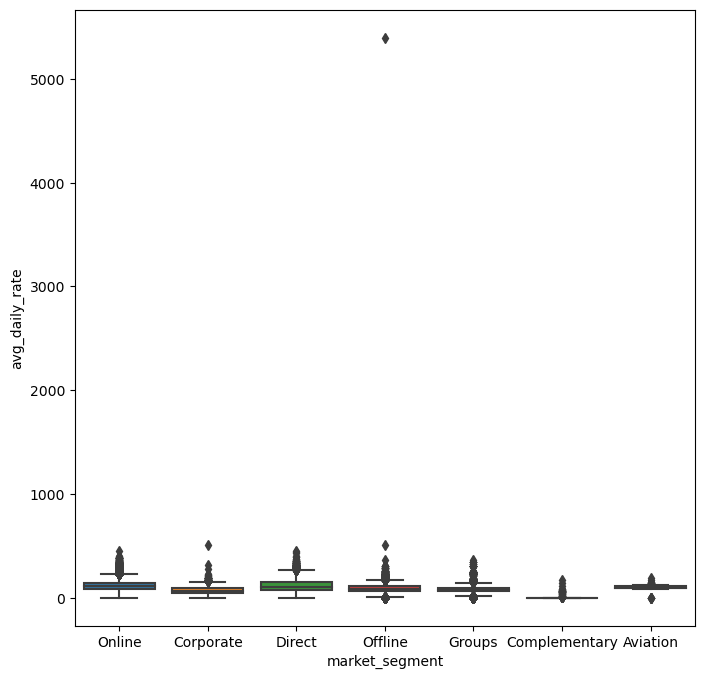

In [17]:
plt.figure(figsize=(8,8))
sns.boxplot(data=df, x='market_segment', y='avg_daily_rate')
plt.show()

In [18]:
q1 = df.avg_daily_rate.quantile(0.25)
q3 = df.avg_daily_rate.quantile(0.75)
iqr = q3 - q1
ul = q3 + 1.5 * iqr
ul

211.065

In [19]:
df.loc[df['avg_daily_rate'] >= 500, 'avg_daily_rate'] = ul

<Axes: xlabel='market_segment', ylabel='avg_daily_rate'>

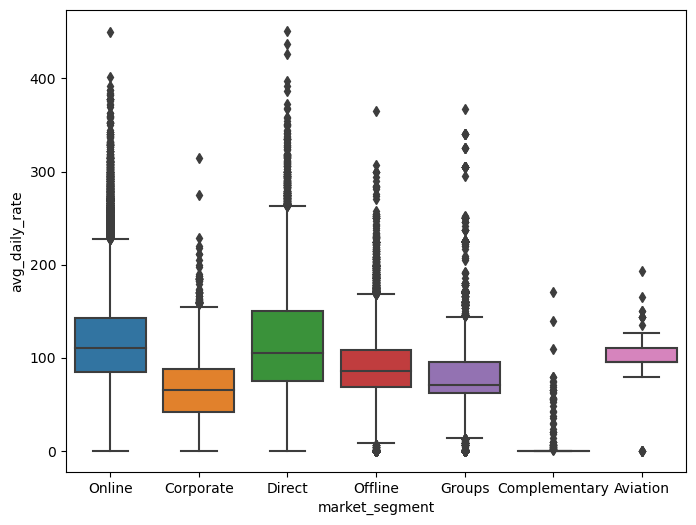

In [20]:
plt.figure(figsize=(8,6))
sns.boxplot(data=df, x='market_segment', y='avg_daily_rate')

* Rooms booked Online and Direct have high variation in the prices.
* Complementary type segment has the very low price.
* While Coroprate, Offline and Groups segments have the almost the similar room prices.

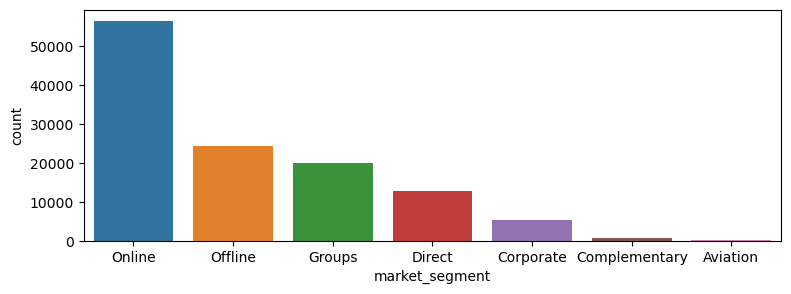

In [21]:
plt.figure(figsize=(9,3))
sns.countplot(data = df, x = 'market_segment', order=df['market_segment'].value_counts().sort_values(ascending=False).index)
plt.show()

In [22]:
stacked = (pd.crosstab(df['market_segment'], df['is_canceled'], normalize='index')*100)
stacked

is_canceled,0,1
market_segment,,
Aviation,78.059072,21.940928
Complementary,86.944818,13.055182
Corporate,81.265345,18.734655
Direct,84.658099,15.341901
Groups,38.937964,61.062036
Offline,65.678543,34.321457
Online,63.278857,36.721143


Text(0, 0.5, 'Percentage Cancellation')

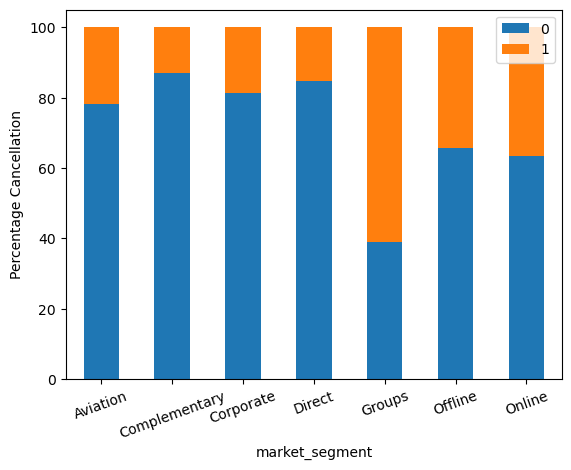

In [23]:
stacked.plot(kind = 'bar', stacked = True)
plt.legend(loc = 'upper right')
plt.xticks(rotation=20)
plt.ylabel("Percentage Cancellation")

* Complementary and Direct booking are the common customer with the lowest percentage of cancellation rate, while the Groups customers along with Online and Offline customers have the higher cancallation rate.
* As per the graph show above, companies should target the Online and Offline customers in addition to Groups booking customers.
* Corporate and Aviation customers also have the higher cancellation rates that hotel should focus on it.

In [24]:
stacked_deposit = (pd.crosstab(df['deposit_type'], df['is_canceled'], normalize='index')*100)
stacked

is_canceled,0,1
market_segment,,
Aviation,78.059072,21.940928
Complementary,86.944818,13.055182
Corporate,81.265345,18.734655
Direct,84.658099,15.341901
Groups,38.937964,61.062036
Offline,65.678543,34.321457
Online,63.278857,36.721143


Text(0, 0.5, 'Percentage Cancellation')

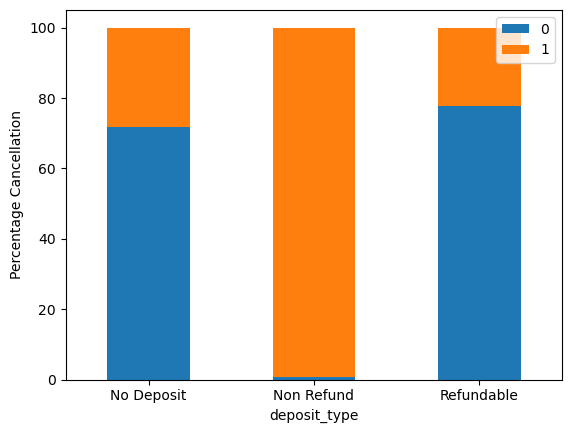

In [25]:
stacked_deposit.plot(kind = 'bar', stacked = True)
plt.legend(loc = 'upper right')
plt.xticks(rotation = 0)
plt.ylabel("Percentage Cancellation")

* Non-Refundable deposit type results almost 100% cancellation percentage, while the Non-Deposit and Refundable type retain almost 75% of reservation.
* The importance of the deposit type in reservation management is immense.

In [26]:
stacked_repeated = (pd.crosstab(df['is_repeated_guest'], df['is_canceled'], normalize='index')*100)
stacked_repeated

is_canceled,0,1
is_repeated_guest,,
0,62.214916,37.785084
1,85.511811,14.488189


Text(0, 0.5, 'Percentage Cancellation')

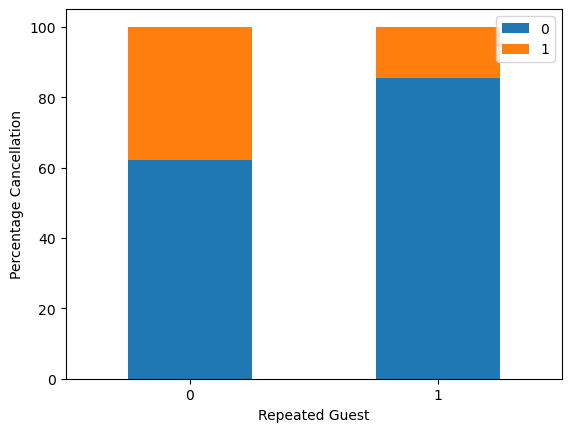

In [27]:
stacked_repeated.plot(kind = 'bar', stacked = True)
plt.legend(loc = 'upper right')
plt.xticks(rotation=0)
plt.xlabel('Repeated Guest')
plt.ylabel("Percentage Cancellation")

* The rate of cancellation of non-repeated guest is higher than repeated guest:
    - It's important for management to focus on improving the experience of non-repeated guest.

In [28]:
months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
grup = df.groupby('arrival_date_month', as_index=False).agg({'avg_daily_rate':'mean'})
grup['arrival_date_month'] = pd.Categorical(grup['arrival_date_month'], categories=months, ordered=True)
grup = grup.sort_values('arrival_date_month')
grup

,arrival_date_month,avg_daily_rate
4,January,70.361241
3,February,73.582276
7,March,80.150490
0,April,100.380790
8,May,108.670163
6,June,116.672192
5,July,126.764560
1,August,140.111523
11,September,105.049657
10,October,87.908879


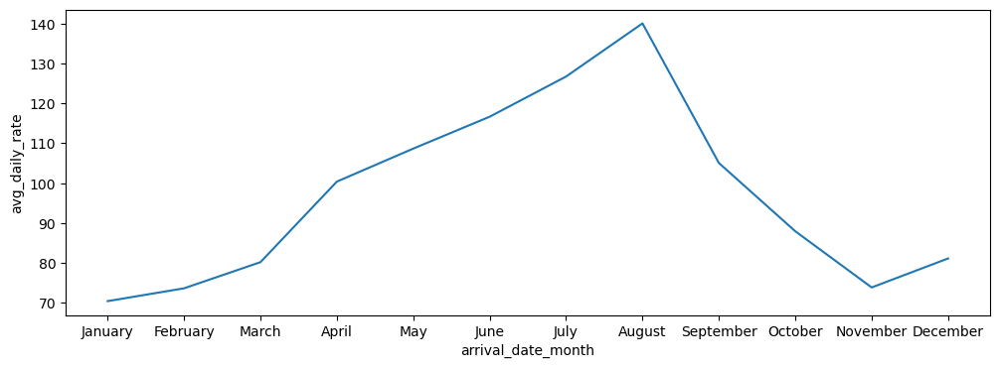

In [29]:
plt.figure(figsize=(12,4))
sns.lineplot(x = grup['arrival_date_month'], y = grup['avg_daily_rate'])
plt.show()

* Room price typically start to increase from March reach their peak in August and then gradually decresing afterward.

##### Model Making

##### 1. Data Import

In [30]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,...,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,avg_daily_rate,required_car_parking_spaces,total_of_special_requests
0,City Hotel,0,37,2016,January,0,2,2,0,BB,...,0,0,0,D,1,No Deposit,0,84.45,0,1
1,City Hotel,0,11,2015,October,2,1,1,0,BB,...,0,0,0,B,1,No Deposit,0,95.00,0,0
2,Resort Hotel,0,21,2015,July,2,3,2,0,HB,...,0,0,0,C,1,No Deposit,0,165.00,1,3
3,Resort Hotel,1,116,2016,June,3,5,2,0,BB,...,0,0,0,C,0,No Deposit,0,145.88,0,0
4,Resort Hotel,1,345,2016,September,2,7,2,0,BB,...,0,0,0,G,2,No Deposit,0,145.00,0,1


##### 2. Data Pre-Processing

In [31]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   stays_in_weekend_nights         119390 non-null  int64  
 6   stays_in_week_nights            119390 non-null  int64  
 7   adults                          119390 non-null  int64  
 8   children                        119390 non-null  int64  
 9   meal                            119390 non-null  object 
 10  market_segment                  119390 non-null  object 
 11  is_repeated_guest               119390 non-null  int64  
 12  previous_cancell

In [32]:
df.isna().sum()

hotel                             0
is_canceled                       0
lead_time                         0
arrival_date_year                 0
arrival_date_month                0
stays_in_weekend_nights           0
stays_in_week_nights              0
adults                            0
children                          0
meal                              0
market_segment                    0
is_repeated_guest                 0
previous_cancellations            0
previous_bookings_not_canceled    0
assigned_room_type                0
booking_changes                   0
deposit_type                      0
days_in_waiting_list              0
avg_daily_rate                    0
required_car_parking_spaces       0
total_of_special_requests         0
dtype: int64

In [33]:
fig.show()

##### 3. Labeling the Data

In [34]:
df_num = df.select_dtypes(include=[np.number])
df_num.head()

,is_canceled,lead_time,arrival_date_year,stays_in_weekend_nights,stays_in_week_nights,adults,children,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,avg_daily_rate,required_car_parking_spaces,total_of_special_requests
0,0,37,2016,0,2,2,0,0,0,0,1,0,84.45,0,1
1,0,11,2015,2,1,1,0,0,0,0,1,0,95.00,0,0
2,0,21,2015,2,3,2,0,0,0,0,1,0,165.00,1,3
3,1,116,2016,3,5,2,0,0,0,0,0,0,145.88,0,0
4,1,345,2016,2,7,2,0,0,0,0,2,0,145.00,0,1


In [35]:
df_cat = df.select_dtypes(include=['object'])
df_cat.head()

,hotel,arrival_date_month,meal,market_segment,assigned_room_type,deposit_type
0,City Hotel,January,BB,Online,D,No Deposit
1,City Hotel,October,BB,Corporate,B,No Deposit
2,Resort Hotel,July,HB,Direct,C,No Deposit
3,Resort Hotel,June,BB,Direct,C,No Deposit
4,Resort Hotel,September,BB,Online,G,No Deposit


In [36]:
from sklearn.preprocessing import LabelEncoder
df_cat = df_cat.apply(LabelEncoder().fit_transform)
df_cat.head(3)

,hotel,arrival_date_month,meal,market_segment,assigned_room_type,deposit_type
0,0,4,0,6,3,0
1,0,10,0,2,1,0
2,1,5,2,3,2,0


In [37]:
df = pd.concat([df_num, df_cat], axis=1)
df.head()

,is_canceled,lead_time,arrival_date_year,stays_in_weekend_nights,stays_in_week_nights,adults,children,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,...,days_in_waiting_list,avg_daily_rate,required_car_parking_spaces,total_of_special_requests,hotel,arrival_date_month,meal,market_segment,assigned_room_type,deposit_type
0,0,37,2016,0,2,2,0,0,0,0,...,0,84.45,0,1,0,4,0,6,3,0
1,0,11,2015,2,1,1,0,0,0,0,...,0,95.00,0,0,0,10,0,2,1,0
2,0,21,2015,2,3,2,0,0,0,0,...,0,165.00,1,3,1,5,2,3,2,0
3,1,116,2016,3,5,2,0,0,0,0,...,0,145.88,0,0,1,6,0,3,2,0
4,1,345,2016,2,7,2,0,0,0,0,...,0,145.00,0,1,1,11,0,6,6,0


##### 3. Data Partition

In [38]:
from sklearn.model_selection import train_test_split

X = df.drop(['is_canceled'], axis = 1)
y = df['is_canceled']

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, random_state = 42)

In [39]:
df.shape

(119390, 21)

##### 4. Model Building (Random Forest)

##### Grid Search method

In [40]:
paras = {'min_samples_split': [50, 75, 150, 250], 
         'min_samples_leaf': [10, 30, 50, 70],
         'max_depth': np.arange(2, 7, 2)}

In [41]:
from sklearn.tree import DecisionTreeClassifier

In [42]:
from sklearn.model_selection import GridSearchCV

grid_search = GridSearchCV(DecisionTreeClassifier(random_state=42),
                           paras,
                           verbose=1,
                           cv=10)
grid_search.fit(X_train, y_train)

Fitting 10 folds for each of 48 candidates, totalling 480 fits


GridSearchCV(cv=10, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_depth': array([2, 4, 6]),
                         'min_samples_leaf': [10, 30, 50, 70],
                         'min_samples_split': [50, 75, 150, 250]},
             verbose=1)

In [43]:
grid_search.best_estimator_

DecisionTreeClassifier(max_depth=6, min_samples_leaf=10, min_samples_split=50,
                       random_state=42)

In [44]:
from sklearn.ensemble import RandomForestClassifier

Model = RandomForestClassifier(n_estimators=25,
                               criterion='gini',
                               max_depth=6,
                               min_samples_leaf=10,
                               min_samples_split=50,
                               max_features='sqrt')
Model.fit(X_train, y_train)

RandomForestClassifier(max_depth=6, min_samples_leaf=10, min_samples_split=50,
                       n_estimators=25)

##### Important Features

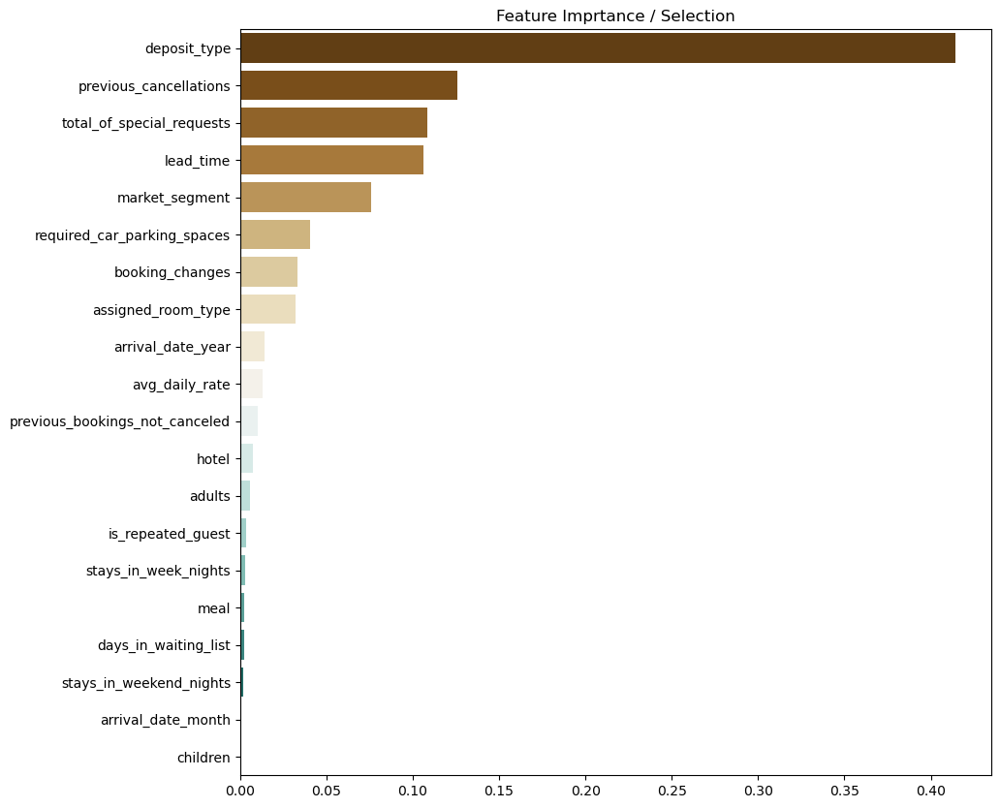

In [45]:
imp = pd.Series(data = Model.feature_importances_, index = Model.feature_names_in_).sort_values(ascending=False)
plt.figure(figsize=(10, 10))
plt.title("Feature Imprtance / Selection")
ax = sns.barplot(y = imp.index, x = imp.values, palette = 'BrBG', orient = 'h')

* The most important features are the deposit type, previous cancellation and lead time.
* Parking space availability also have the impact on the resevation, market segment also is one of the important aspect in resevation retention.

##### Random Forest Visulization

In [46]:
from sklearn.tree import export_graphviz
import pydot

In [47]:
list(X.columns)

['lead_time',
 'arrival_date_year',
 'stays_in_weekend_nights',
 'stays_in_week_nights',
 'adults',
 'children',
 'is_repeated_guest',
 'previous_cancellations',
 'previous_bookings_not_canceled',
 'booking_changes',
 'days_in_waiting_list',
 'avg_daily_rate',
 'required_car_parking_spaces',
 'total_of_special_requests',
 'hotel',
 'arrival_date_month',
 'meal',
 'market_segment',
 'assigned_room_type',
 'deposit_type']

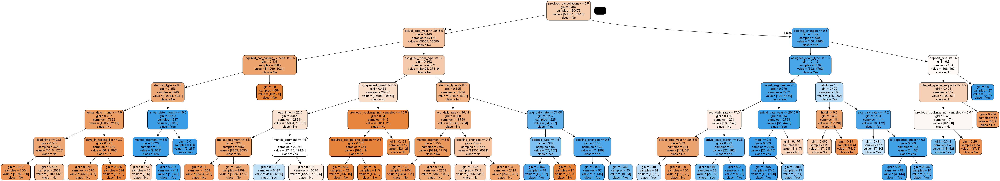

In [48]:
feature_list = list(X.columns)
canceled = ['No', 'Yes']

tree = Model.estimators_[10]

export_graphviz(tree, out_file = 'Project.dot',
                feature_names = feature_list,
                class_names = canceled,
                rounded = True,
                filled = True)
(graph, ) = pydot.graph_from_dot_file('Project.dot')
graph.write_png('project_tree.png')

from IPython.display import Image
Image(filename = 'project_tree.png')

##### 5. Prediction on Train dataset

In [49]:
train = pd.concat([X_train, y_train], axis=1)
train.head()

,lead_time,arrival_date_year,stays_in_weekend_nights,stays_in_week_nights,adults,children,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,...,avg_daily_rate,required_car_parking_spaces,total_of_special_requests,hotel,arrival_date_month,meal,market_segment,assigned_room_type,deposit_type,is_canceled
67702,266,2017,0,3,2,0,0,0,0,0,...,100.00,0,0,0,8,0,4,0,1,1
115851,64,2017,2,1,2,1,0,0,0,0,...,103.50,0,1,0,5,0,5,4,0,0
57345,32,2016,2,2,1,2,0,0,0,1,...,124.25,0,2,0,11,0,6,1,0,1
11622,47,2017,2,5,2,0,0,0,0,0,...,153.57,0,0,1,0,0,6,6,0,1
33333,27,2017,2,5,2,0,0,0,0,1,...,66.40,0,0,1,4,2,6,0,0,0


In [50]:
train['Predicted'] = Model.predict(X_train)
train.head()

,lead_time,arrival_date_year,stays_in_weekend_nights,stays_in_week_nights,adults,children,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,...,required_car_parking_spaces,total_of_special_requests,hotel,arrival_date_month,meal,market_segment,assigned_room_type,deposit_type,is_canceled,Predicted
67702,266,2017,0,3,2,0,0,0,0,0,...,0,0,0,8,0,4,0,1,1,1
115851,64,2017,2,1,2,1,0,0,0,0,...,0,1,0,5,0,5,4,0,0,0
57345,32,2016,2,2,1,2,0,0,0,1,...,0,2,0,11,0,6,1,0,1,0
11622,47,2017,2,5,2,0,0,0,0,0,...,0,0,1,0,0,6,6,0,1,1
33333,27,2017,2,5,2,0,0,0,0,1,...,0,0,1,4,2,6,0,0,0,0


##### 6. Model Performance

In [51]:
from sklearn.metrics import classification_report
print(classification_report(train['is_canceled'], train['Predicted']))

              precision    recall  f1-score   support

           0       0.77      0.97      0.86     60207
           1       0.91      0.51      0.65     35305

    accuracy                           0.80     95512
   macro avg       0.84      0.74      0.76     95512
weighted avg       0.82      0.80      0.78     95512



##### 7. Predictions on Test dataset

In [52]:
test = pd.concat([X_test, y_test], axis=1)
test.head()

,lead_time,arrival_date_year,stays_in_weekend_nights,stays_in_week_nights,adults,children,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,...,avg_daily_rate,required_car_parking_spaces,total_of_special_requests,hotel,arrival_date_month,meal,market_segment,assigned_room_type,deposit_type,is_canceled
30946,48,2016,1,4,2,0,0,0,0,0,...,37.80,0,2,1,9,0,6,0,0,0
40207,155,2017,2,3,2,0,0,0,0,0,...,236.85,0,3,1,1,2,3,0,0,0
103708,104,2016,2,1,0,0,0,0,0,1,...,91.60,0,2,0,2,0,6,0,0,0
85144,0,2016,0,2,1,0,0,0,0,0,...,116.00,0,0,0,7,0,6,3,0,0
109991,143,2017,2,5,2,0,0,0,0,1,...,170.36,0,2,0,0,2,6,3,0,0


In [53]:
test['Predicted'] = Model.predict(X_test)
test.head()

,lead_time,arrival_date_year,stays_in_weekend_nights,stays_in_week_nights,adults,children,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,...,required_car_parking_spaces,total_of_special_requests,hotel,arrival_date_month,meal,market_segment,assigned_room_type,deposit_type,is_canceled,Predicted
30946,48,2016,1,4,2,0,0,0,0,0,...,0,2,1,9,0,6,0,0,0,0
40207,155,2017,2,3,2,0,0,0,0,0,...,0,3,1,1,2,3,0,0,0,0
103708,104,2016,2,1,0,0,0,0,0,1,...,0,2,0,2,0,6,0,0,0,0
85144,0,2016,0,2,1,0,0,0,0,0,...,0,0,0,7,0,6,3,0,0,0
109991,143,2017,2,5,2,0,0,0,0,1,...,0,2,0,0,2,6,3,0,0,0


##### 8. Model Performance

In [54]:
from sklearn.metrics import classification_report
print(classification_report(test['is_canceled'], test['Predicted']))

              precision    recall  f1-score   support

           0       0.77      0.97      0.86     14959
           1       0.91      0.52      0.66      8919

    accuracy                           0.80     23878
   macro avg       0.84      0.74      0.76     23878
weighted avg       0.82      0.80      0.78     23878



In [55]:
import pickle

pickle.dump(Model, open(r'C:\Users\mohds\OneDrive\Desktop\Projects\build.pkl', 'wb'))